In [50]:
from noveltysegmentation import MultiGranularSegmentation
from librosa.feature import rms
import matplotlib.pyplot as plt
import numpy as np
from librosa import load, clicks,  time_to_frames, frames_to_samples, frames_to_time, samples_to_frames
from IPython.display import display, Audio

In [58]:
fname="../../train_subset/014f3712-293b-42af-9f29-0ed1785be792/drums/drums.wav"
#fname="/data3/anasynth_nonbp/bujard/data/moisesdb_v2/train_subset/0358fd1e-244a-4422-9a42-29b5d68f6e4b/other_keys/other_keys.wav"
y, sr = load(fname,sr=None,mono=True,duration=60)
y = y/max(y)
t = np.linspace(0,len(y)/sr,len(y))

In [59]:
w_size = 0.05 #100ms
n_fft = int(w_size*sr) #to samples
mgsegment = MultiGranularSegmentation(sr, n_fft, "robust",20,1,2,min_segment_duration=0.1)

In [60]:
nov, scales = mgsegment.compute_novelty(y)

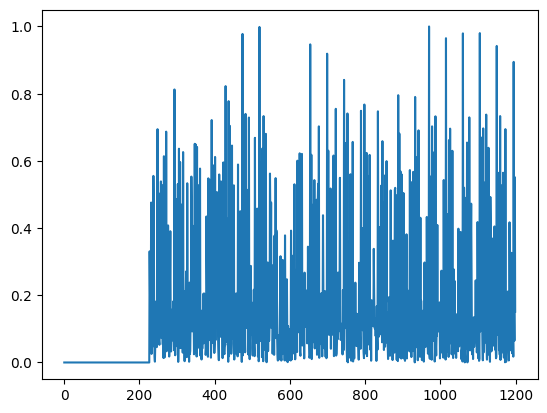

In [61]:
plt.plot(nov)

In [62]:
#compute energy
energy = rms(y=y,frame_length=n_fft,hop_length=n_fft)[0]

In [63]:
print(energy.shape)
print(nov.shape)

(1200,)
(1200,)


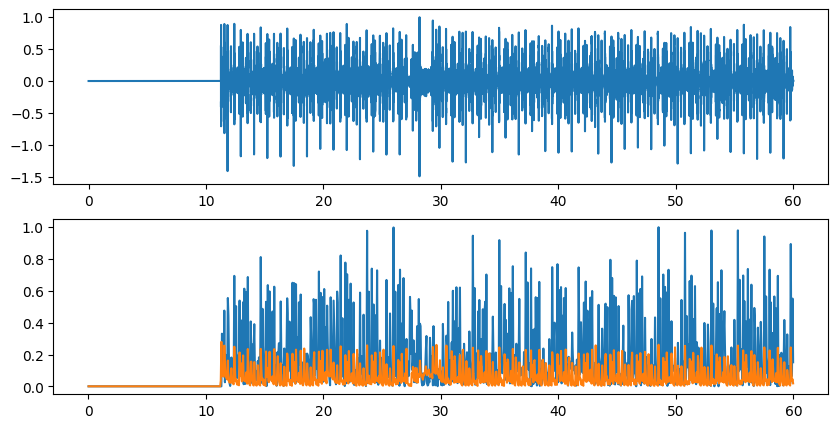

In [64]:
t_ = frames_to_time(range(len(nov)),sr=sr,n_fft=n_fft,hop_length=n_fft)
plt.figure(figsize=(10,5))
plt.subplot(211)
plt.plot(t,y)
plt.subplot(212)
plt.plot(t_,nov)
plt.plot(t_,energy)
plt.show()

## Partir des peaks detectés avec novelty et raffiner le point avec energie

In [65]:
segments, points = mgsegment.segment(y)
points

array([      0,  501637,  523687,  547942,  598657,  647167,  673627,
        746392,  766237,  845617,  865462,  947047, 1019812, 1046272,
       1119037, 1145497, 1169752, 1240312, 1295437, 1330717, 1350562,
       1381432, 1443172, 1493887, 1542397, 1593112, 1641622, 1661467,
       1740847, 1760692, 1840072, 1866532, 1939297, 1959142, 2027497,
       2058367, 2139952, 2239177, 2338402, 2437627, 2457472, 2536852,
       2556697, 2636077, 2646000])

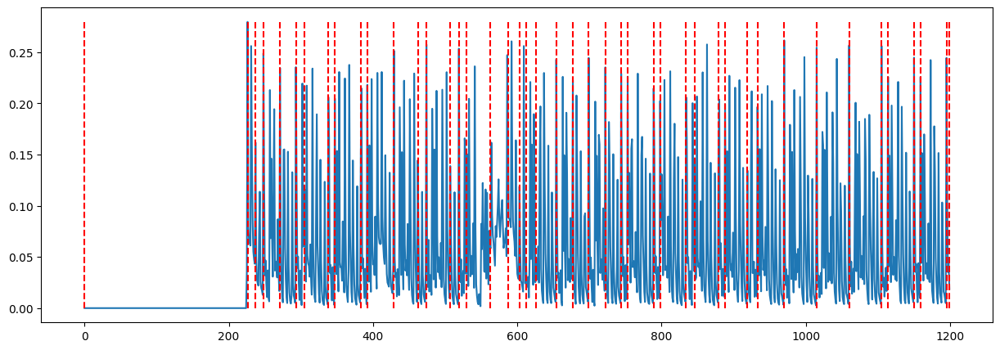

In [66]:
#plot peaks avec anergie pour check alignement
points_frames = samples_to_frames(points, n_fft=n_fft,hop_length=n_fft)
points_frames[0]=0
plt.figure(figsize=(15,5))
plt.plot(energy)
plt.vlines(points_frames,ymin=0,ymax=max(energy),linestyles="--",colors="r")
plt.show()

In [67]:
points_frames

array([   0,  227,  237,  248,  271,  293,  305,  338,  347,  383,  392,
        429,  462,  474,  507,  519,  530,  562,  587,  603,  612,  626,
        654,  677,  699,  722,  744,  753,  789,  798,  834,  846,  879,
        888,  919,  933,  970, 1015, 1060, 1105, 1114, 1150, 1159, 1195,
       1199])

In [68]:
#check minimum in energy curve around point
delta = 0.2 #ms window around peak
delta = time_to_frames(delta,sr=sr,n_fft=n_fft,hop_length=n_fft)
new_points_frames = np.zeros_like(points_frames)
for i,point in enumerate(points_frames[1:],1):
    e = energy[point-delta:point+delta]
    new_point = point + np.argmin(e) - delta
    new_points_frames[i] = new_point



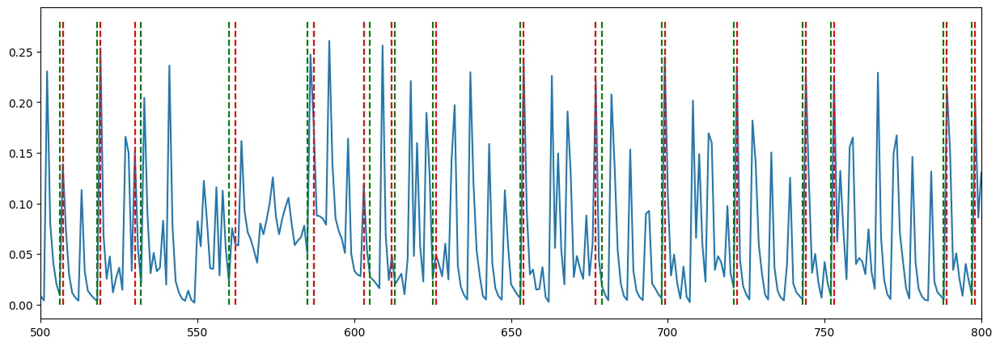

In [69]:
plt.figure(figsize=(15,5))
plt.plot(energy)
plt.vlines(points_frames,ymin=0,ymax=max(energy),linestyles="--",colors="r")
plt.vlines(new_points_frames,ymin=0,ymax=max(energy),linestyles="--",colors="g")
plt.xlim(500,800)
plt.show()

In [70]:
new_points = frames_to_samples(new_points_frames,n_fft=n_fft,hop_length=n_fft)
new_segments=[y[t0:t1] for t0,t1 in zip(new_points[:-1],new_points[1:])]

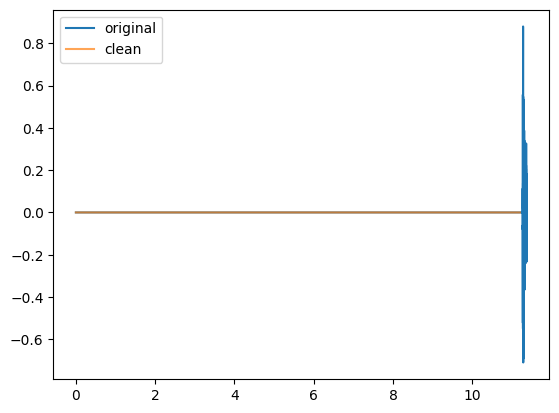

-----


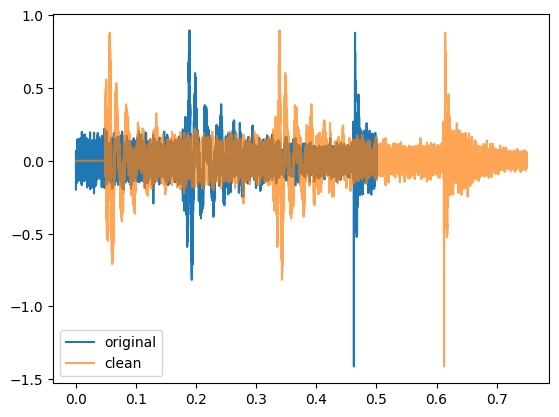

-----


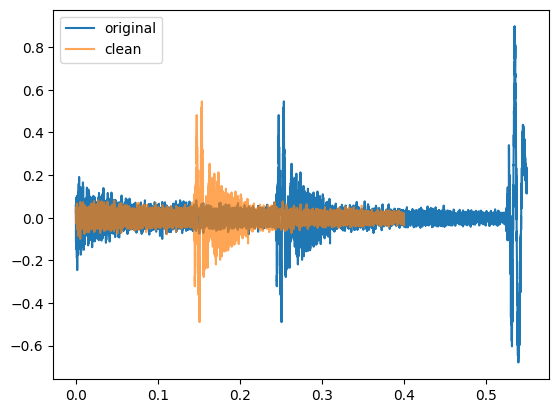

-----


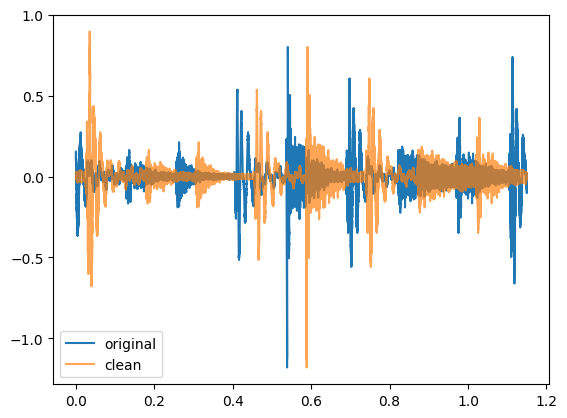

-----


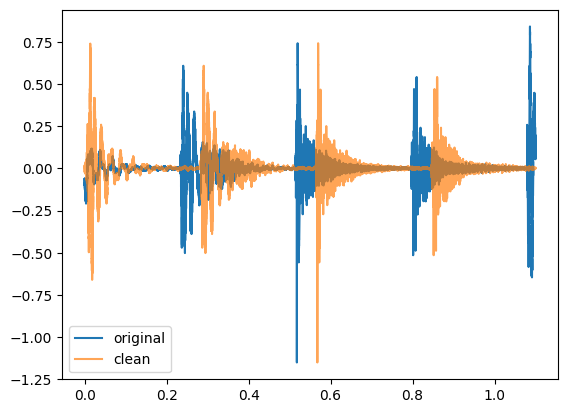

-----


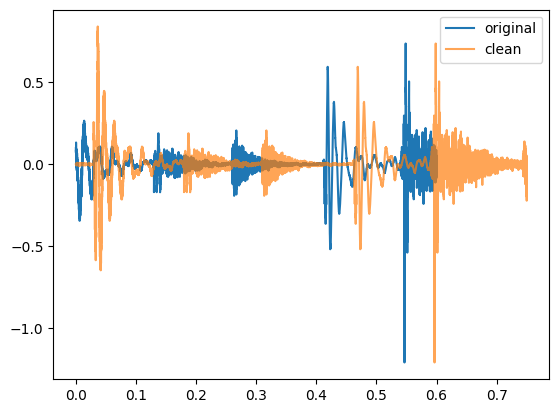

-----


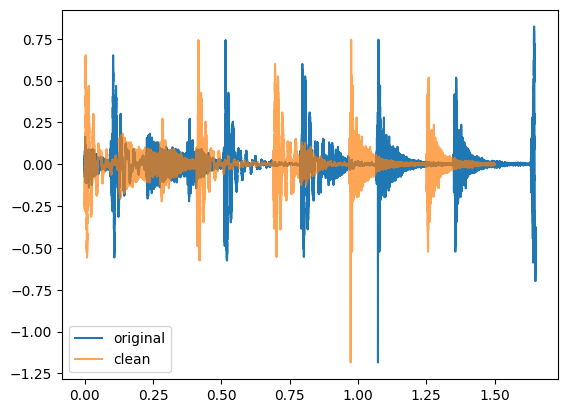

-----


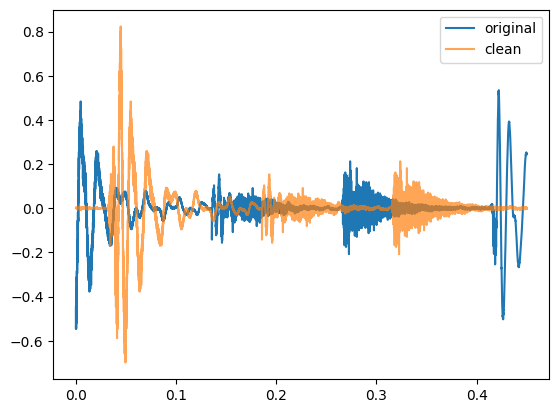

-----


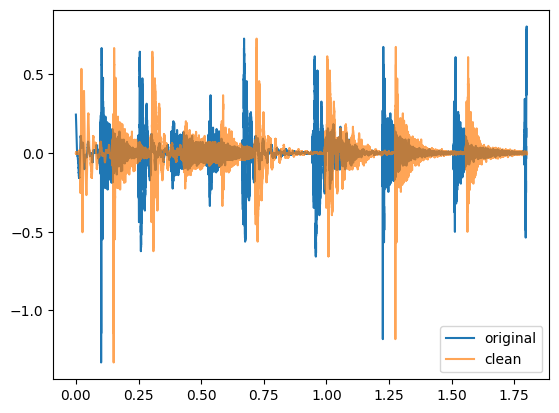

-----


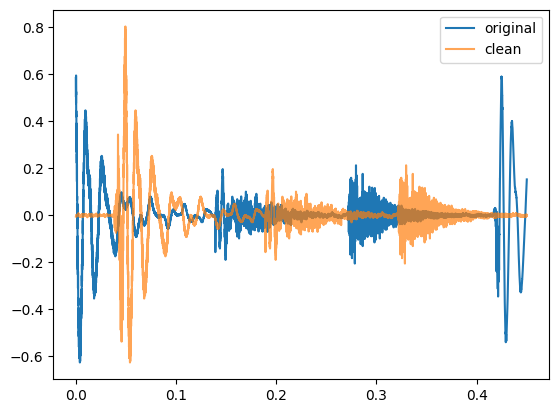

-----


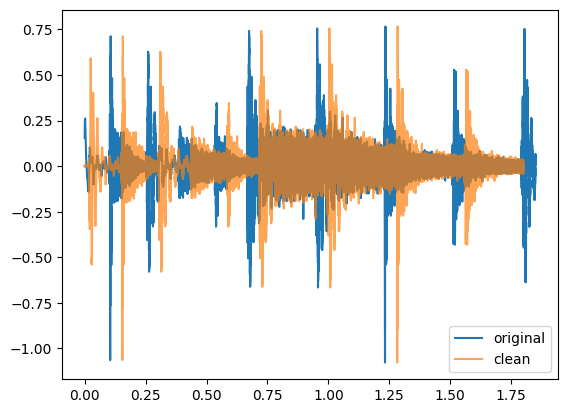

-----


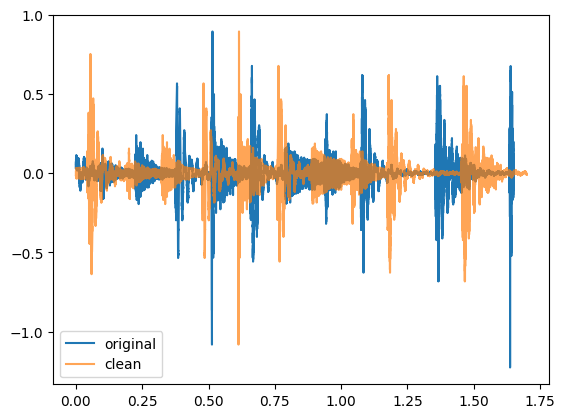

-----


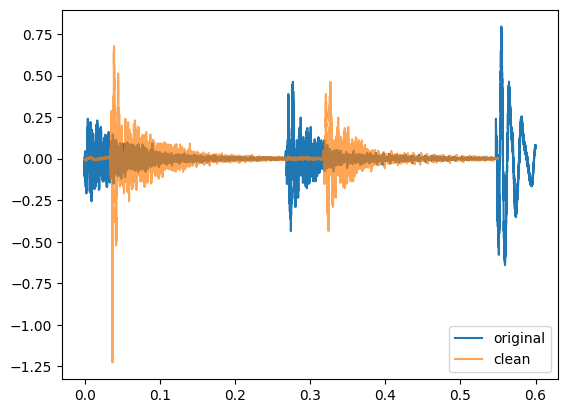

-----


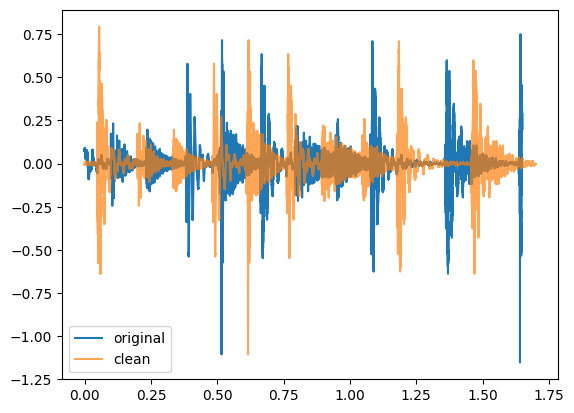

-----


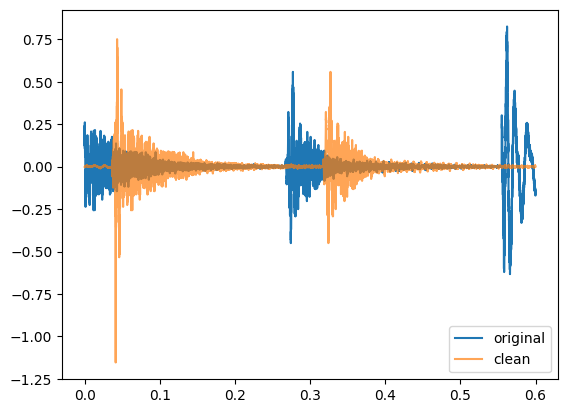

-----


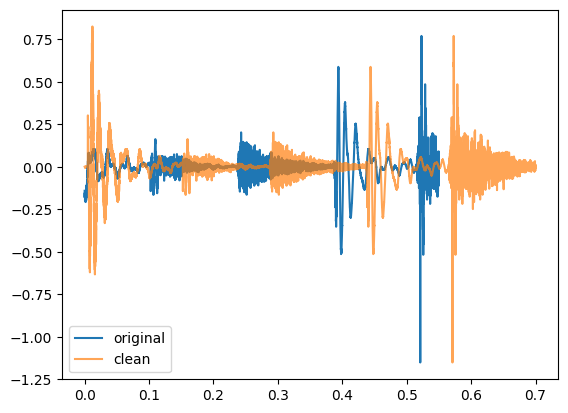

-----


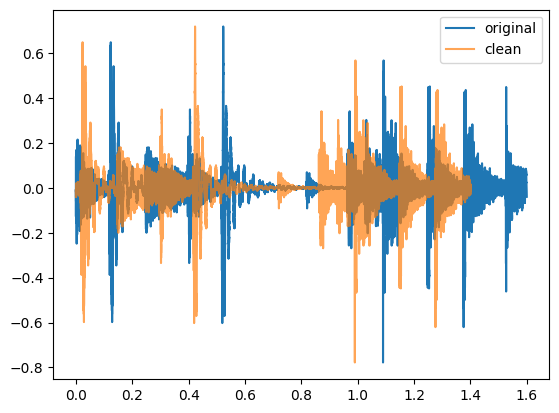

-----


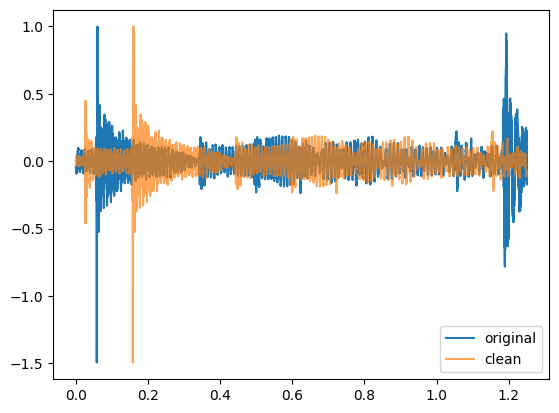

-----


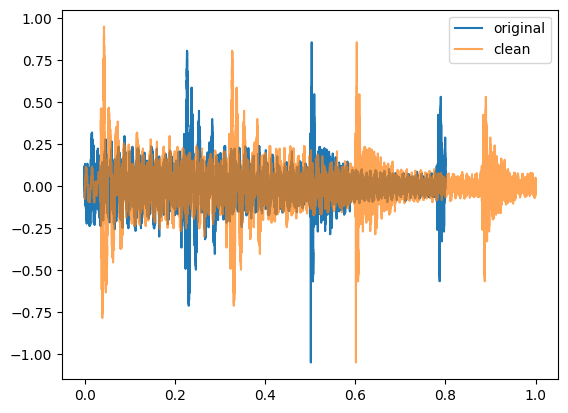

-----


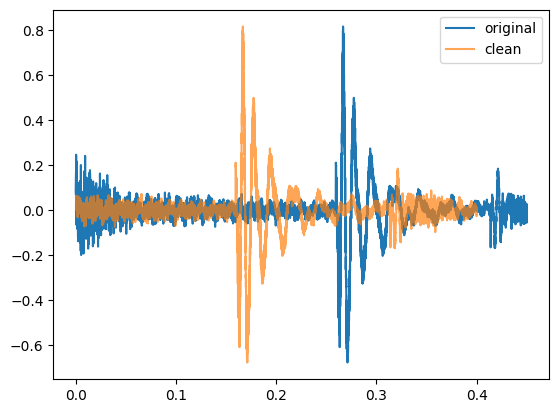

-----


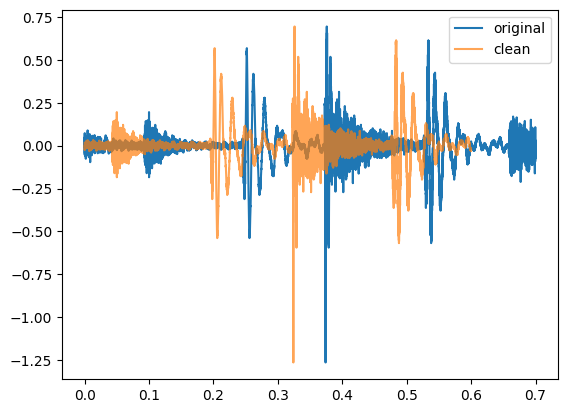

-----


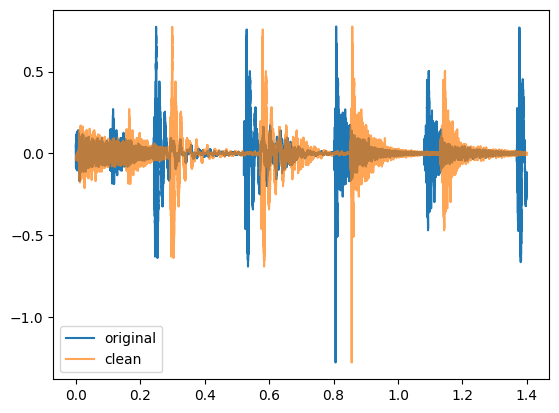

-----


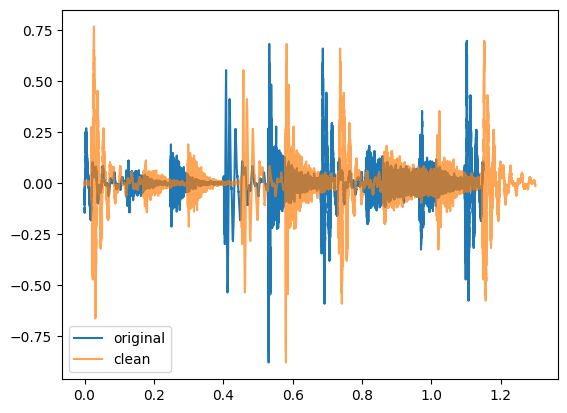

-----


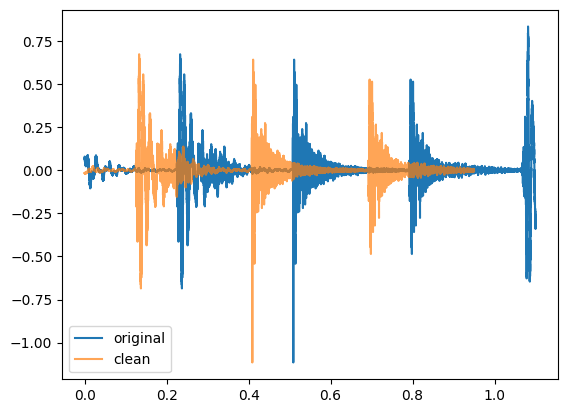

-----


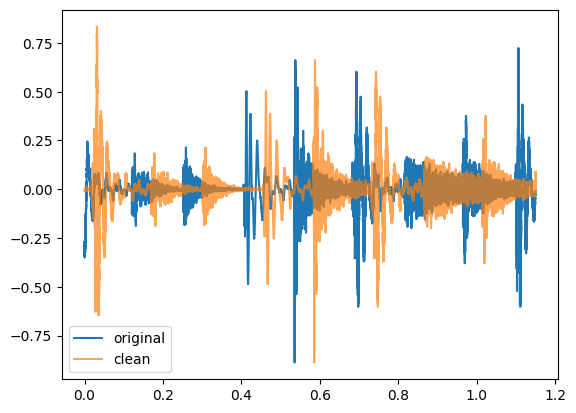

-----


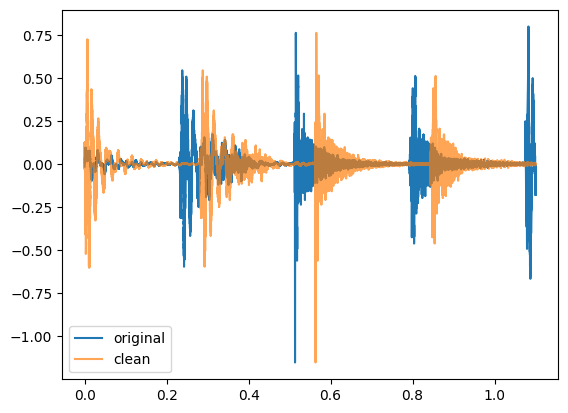

-----


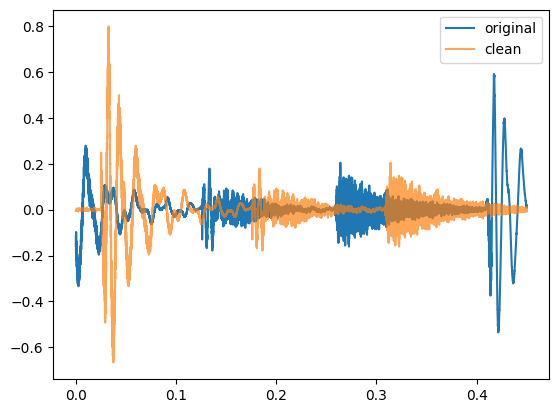

-----


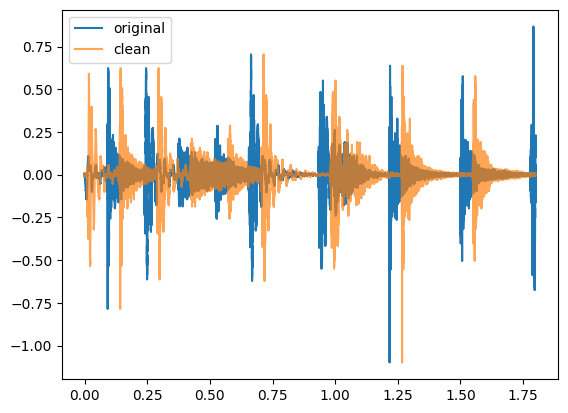

-----


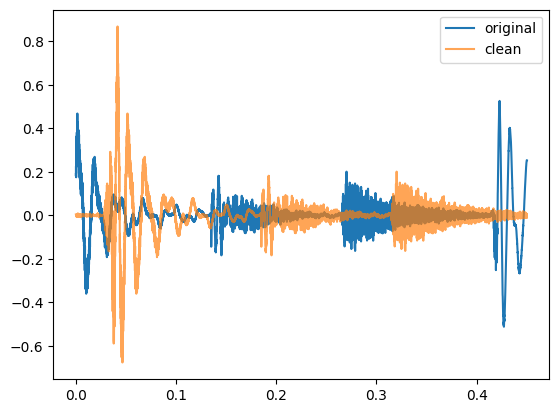

-----


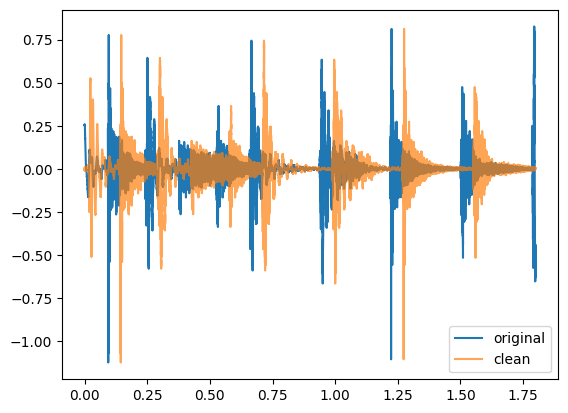

-----


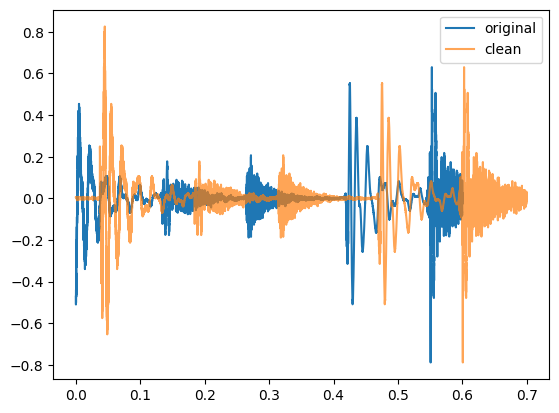

-----


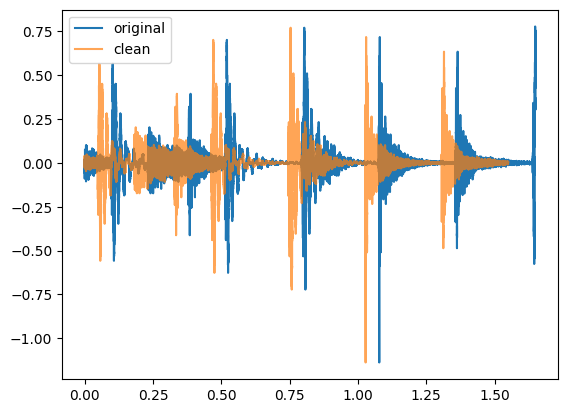

-----


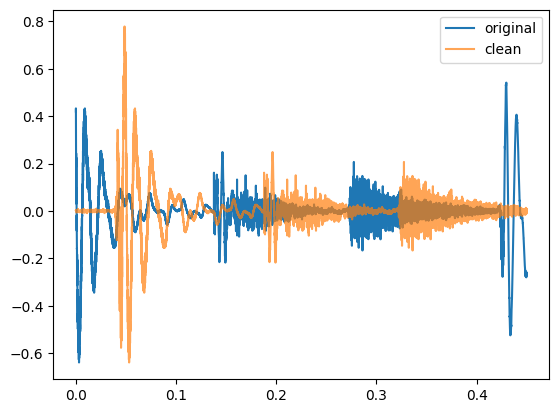

-----


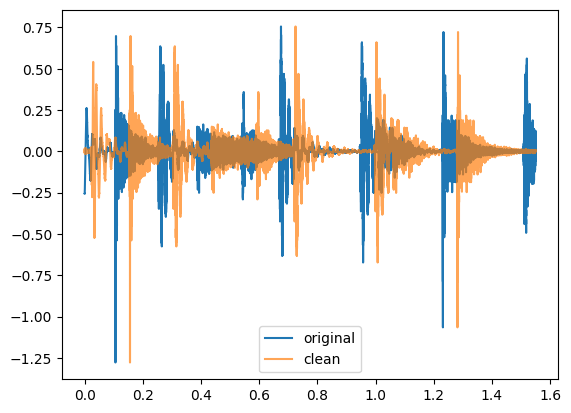

-----


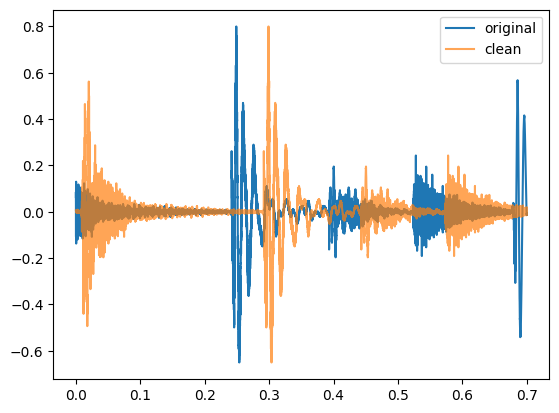

-----


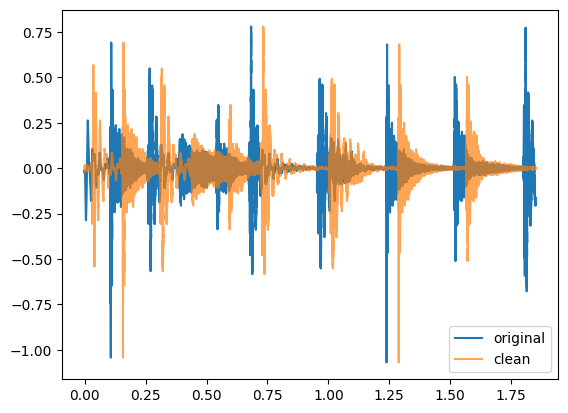

-----


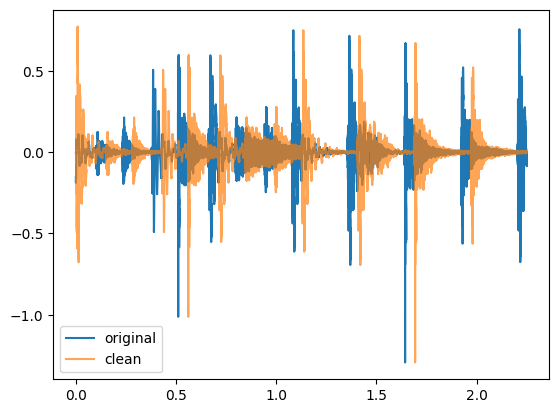

-----


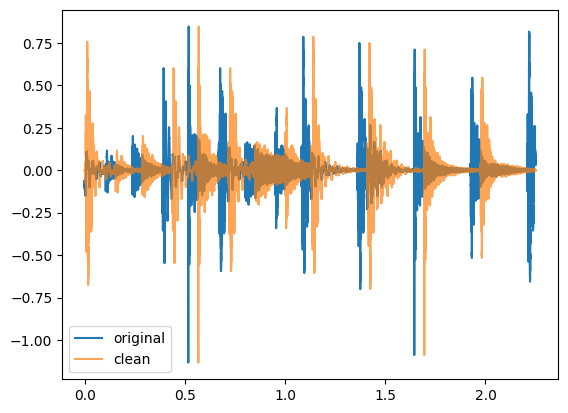

-----


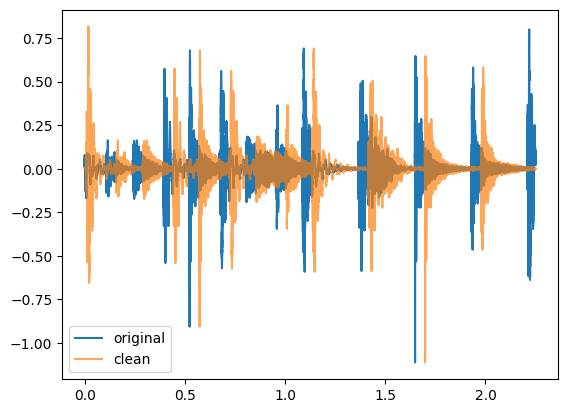

-----


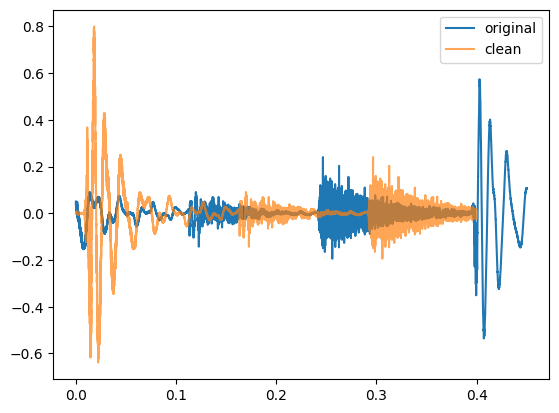

-----


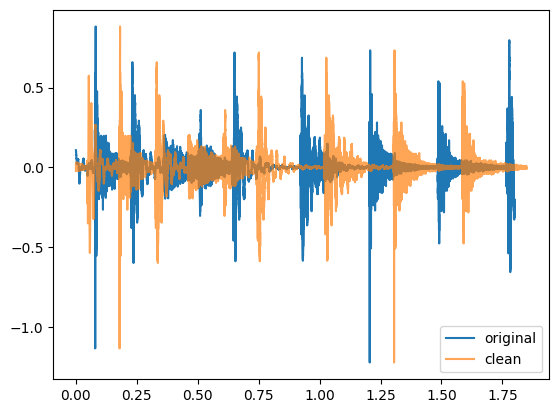

-----


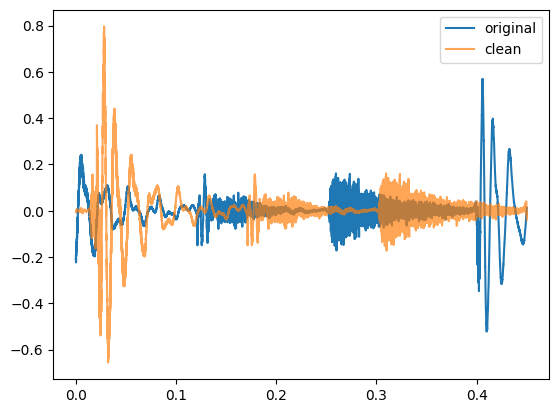

-----


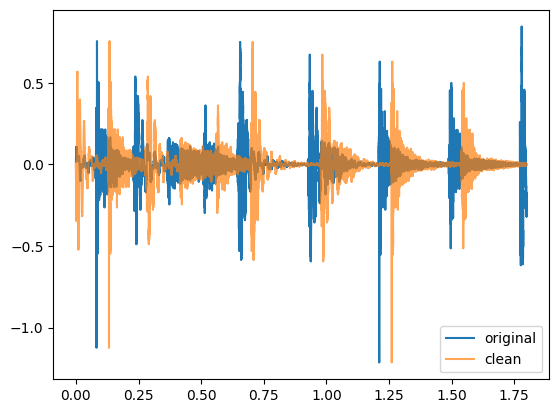

-----


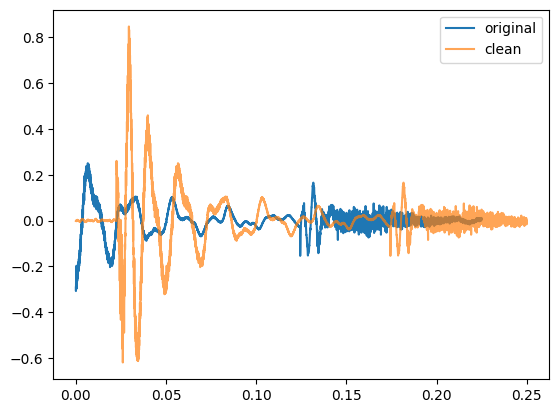

-----


In [71]:
t0=0
for segment, new_segment in zip(segments,new_segments):
    # t1 = t0+len(new_segment)/sr
    # t_ = np.linspace(t0,t1,len(new_segment))
    t_ = np.linspace(0,len(segment)/sr,len(segment))
    plt.plot(t_,segment,label="original")
    t_ = np.linspace(0,len(new_segment)/sr,len(new_segment))
    plt.plot(t_,new_segment, alpha=0.7, label="clean")
    plt.legend()
    # t0=t1
    plt.show()
    display(Audio(segment,rate=sr))
    display(Audio(new_segment,rate=sr))
    print("-"*5)

#plt.xlim(10,20)
#plt.show()

In [74]:
y_click = y + clicks(times=new_points/sr,sr=sr,length=len(y))
display(Audio(y_click,rate=sr))